The goal of this notebook is to test if the Segment-Anything model from Meta could be used to smooth cost annotations.

The idea is that models from `model_development/multimodal_velocity_regression_alt` proposes interesting results but still quite noisy. This can be observed with `Testing_Results/result_quantifier.py`. A segmentation preprocessing followed by an averaging of patches' predicted traversal costs, significantly reduces this noise. Even though, this pipeline proposes interesting results, when benchmarked on the Jetson Nano, it definitely does not run in real-time (46s for the inference of segment-anything model alone, far from the expected ~30Hz needed). Another notebook is dedicated to the distillation of the pipeline.

To successfully run this notebook, you would need to have Segment Anything's weights in "models/" folder. These can be downloaded from [here](https://github.com/facebookresearch/segment-anything#model-checkpoints). If you only want to test `sam_vit_h.pth` (which is the largest SAM's model and the one we used), please download it [here](https://dl.fbaipublicfiles.com/segment_anything/sam_vit_h_4b8939.pt.h).

In [1]:
from params import PROJECT_PATH
import torch
from PIL import Image
import numpy as np
import pandas as pd
from ipywidgets import interact
import matplotlib.pyplot as plt
from matplotlib import patches
from tqdm import tqdm
from functools import lru_cache

from pathlib import Path
from functools import reduce

from utils.grid import get_grid_lists
import params.dataset
from sam_pipeline_utils import (
    get_mask_generator,
    get_vision_model,
    get_random_patch,
    _sample_random_patches,
    _keep_most_centered_patches,
    _get_cost_of_patch,
    get_cost,
    get_center_cost,
    get_iqm_center_cost,
    compute_completeness,
    filter_intersection,
    downsample_to_grid,
)

Failed to load Python extension for LZ4 support. LZ4 compression will not be available.


In [2]:
dir_path = PROJECT_PATH / "bagfiles/images_extracted/"


def get_image(img_path: Path) -> np.array:
    with Image.open(img_path) as pil_img:
        return np.array(pil_img)


img = get_image(dir_path / "00024.png")
depth = get_image(dir_path / "00024d.png")
normal = get_image(dir_path / "00024n.png")

In [3]:
mask_generator = get_mask_generator()

In [4]:
masks = mask_generator.generate(img)

In [5]:
masks

[{'segmentation': array([[False, False, False, ..., False, False, False],
         [False, False, False, ..., False, False, False],
         [False, False, False, ..., False, False, False],
         ...,
         [ True,  True,  True, ..., False, False, False],
         [ True,  True,  True, ..., False, False, False],
         [False, False, False, ..., False, False, False]]),
  'area': 18990,
  'bbox': [0, 905, 130, 173],
  'predicted_iou': 1.0145132541656494,
  'point_coords': [[90.0, 961.875]],
  'stability_score': 0.9899349808692932,
  'crop_box': [0, 0, 1920, 1080]},
 {'segmentation': array([[False, False, False, ..., False, False, False],
         [False, False, False, ..., False, False, False],
         [False, False, False, ..., False, False, False],
         ...,
         [False, False, False, ..., False, False, False],
         [False, False, False, ..., False, False, False],
         [False, False, False, ..., False, False, False]]),
  'area': 160643,
  'bbox': [0, 268, 1757

In [6]:
def random_color(_):
    return np.concatenate([np.random.random(3), [0.35]])


def mask_to_color_annotation(
    anns, color_fct=random_color, is_tqdm: bool = True
):
    if len(anns) == 0:
        return

    img = np.ones(
        (
            anns[0]["segmentation"].shape[0],
            anns[0]["segmentation"].shape[1],
            4,
        )
    )
    img[:, :, 3] = 0

    anns = sorted(anns, key=(lambda x: x["area"]), reverse=True)
    it = tqdm(anns) if is_tqdm else anns
    for ann in it:
        m = ann["segmentation"]
        color_mask = color_fct(ann)
        img[m] = color_mask

    return img


def get_color_annotation(img, *, color_fct=random_color):
    masks = mask_generator.generate(img)
    return mask_to_color_annotation(masks, color_fct=color_fct)


@interact()
def plot(img_path=dir_path.glob("*[!nd].png")):
    img = get_image(img_path)
    plt.imshow(img)

    color_mask = get_color_annotation(img)

    plt.gca().set_autoscale_on(False)
    plt.imshow(color_mask)

interactive(children=(Dropdown(description='img_path', options=(PosixPath('/home/g_thomas/Documents/PRE/bagfil…

# Removing intersection of masks
(Usefull to prevent any biais on the costmasp)

In [7]:
exclusive_masks = filter_intersection(masks)

In [8]:
%%script false --no-raise-error

color_mask = mask_to_color_annotation(masks)
color_exclusive_mask = mask_to_color_annotation(exclusive_masks)

_, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 15))
ax1.imshow(color_mask)
ax1.set_title(f"Previous masks\n{len(masks)} masks")
ax2.imshow(color_exclusive_mask)
ax2.set_title(f"Filtered masks\n{len(masks)} masks")

In [9]:
%%script false --no-raise-error

# Same nb of pxls?
nb_pxls = np.sum(reduce(np.logical_or, [m["segmentation"] for m in masks]))

nb_filtered_pxls = np.sum(
    reduce(np.logical_or, [m["segmentation"] for m in exclusive_masks])
)

nb_pxls, nb_filtered_pxls

In [10]:
%%script false --no-raise-error

nb_pxls = sum(np.sum(m["segmentation"]) for m in masks)
nb_filtered_pxls = sum(np.sum(m["segmentation"]) for m in exclusive_masks)

nb_pxls, nb_filtered_pxls

# Try coloring with our model's cost rather than random color

100%|██████████| 1/1 [00:00<00:00, 80.91it/s]

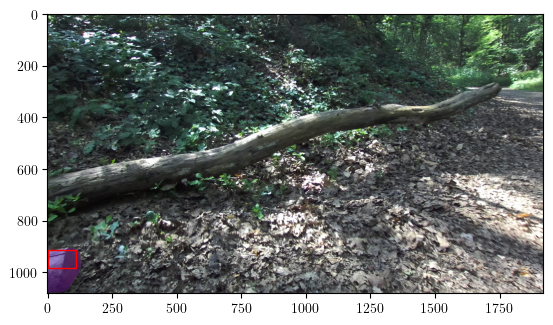

In [11]:
plt.imshow(img)
color_mask = mask_to_color_annotation([masks[0]])

plt.gca().set_autoscale_on(False)
plt.imshow(color_mask)

patch = get_random_patch(masks[0]["segmentation"])
rect = patches.Rectangle(
    (patch.min_x, patch.min_y),
    patch.max_x - patch.min_x,
    patch.max_y - patch.min_y,
    linewidth=1,
    edgecolor="r",
    facecolor="none",
)
plt.gca().add_patch(rect)

In [12]:
model = get_vision_model()

In [13]:
import matplotlib.cm as cmx
import matplotlib.colors as colors

from utils.model import get_model_input

norm = colors.Normalize(vmin=3, vmax=6)
colormap = cmx.ScalarMappable(norm=norm, cmap="hot_r")


def get_color_by_cost(
    mask, img, depth, normal, *, nb_patch: int = 10, alpha: float = 0.55
) -> np.array:
    cost = get_cost(mask, img, depth, normal, nb_patch=nb_patch)
    if cost is None:
        return np.array([0, 0, 0, 0])

    return colormap.to_rgba(cost, alpha=alpha)

In [14]:
%%script false --no-raise-error

plt.imshow(img)
color_mask = mask_to_color_annotation(
    masks, color_fct=lambda mask: get_color_by_cost(mask, img, depth, normal)
)
plt.gca().set_autoscale_on(False)
plt.imshow(color_mask)

# How to improve stability of the costmap?
i.e. from run to run, the costmap regurlarly changes a lot.

This is due to the random sampling of the patches's position to infer traversability cost. One time, some patches might be too much on the edge and hence bias the costmap.

In [15]:
img_path = dir_path / "2.png"
img = get_image(img_path)
depth = get_image(img_path.parent / (img_path.stem + "d.png"))
normal = get_image(img_path.parent / (img_path.stem + "n.png"))
masks = mask_generator.generate(img)

100%|██████████| 1/1 [00:00<00:00, 81.44it/s]


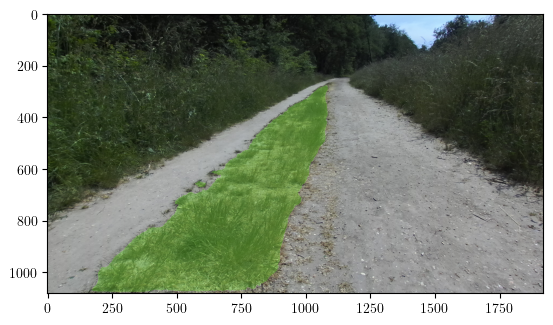

In [16]:
plt.imshow(img)
color_mask = mask_to_color_annotation([masks[0]])

plt.gca().set_autoscale_on(False)
plt.imshow(color_mask)

In [20]:
segmentation = masks[0]["segmentation"]
nb_patch = 10

patches_list = _sample_random_patches(segmentation, nb_patch=nb_patch)
costs = map(
    lambda patch: _get_cost_of_patch(img, depth, normal, patch),
    patches_list,
)
costs = list(costs)

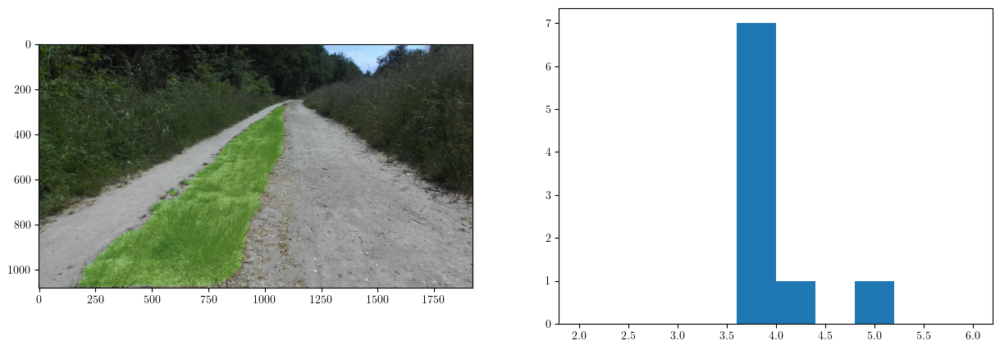

In [21]:
def plot_patches(
    img: np.array, color_mask: np.array, patches_list: list, costs: list
) -> None:
    _, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 5))
    ax2.hist(costs, range=(2, 6))
    ax1.imshow(img)

    for patch in patches_list:
        rect = patches.Rectangle(
            (patch.min_x, patch.min_y),
            patch.max_x - patch.min_x,
            patch.max_y - patch.min_y,
            linewidth=1,
            edgecolor="r",
            facecolor="none",
        )
        ax1.add_patch(rect)
    ax1.set_autoscale_on(False)
    ax1.imshow(color_mask)


plot_patches(img, color_mask, patches_list, costs)

In [22]:
def compute_entropy(
    get_cost,
    mask: np.array,
    img: np.array,
    depth: np.array,
    normal: np.array,
    *,
    nb_calls: int = 100,
):
    costs = []
    for _ in range(nb_calls):
        cost = get_cost(mask, img, depth, normal)
        if cost is not None:
            costs.append(cost)

    return np.std(costs)

In [23]:
%%script false --no-raise-error

default_strategy_entropy = compute_entropy(
    get_cost, masks[0], img, depth, normal
)
default_strategy_entropy

## Effect of nb_patch

In [24]:
%%script false --no-raise-error

nb_patch_list = np.geomspace(10, 200, 5, dtype=int)

default_entropy_list = []
for nb_patch in tqdm(nb_patch_list, desc="Computing stability"):
    entropy = compute_entropy(
        lambda mask, img, depth, normal: get_cost(
            mask, img, depth, normal, nb_patch=nb_patch
        ),
        masks[0],
        img,
        depth,
        normal,
    )
    default_entropy_list.append(entropy)

In [25]:
%%script false --no-raise-error

plt.plot(nb_patch_list, default_entropy_list)
plt.ylabel("Entropy")
plt.xlabel("Number of patches")
plt.title("Stability of the costmap for the default cost computation strategy")

## Take the most centered patches?

In [26]:
%%script false --no-raise-error

centered_strategy_entropy = compute_entropy(
    get_center_cost, masks[0], img, depth, normal
)
centered_strategy_entropy

In [52]:
from functools import partial
from time import time


nb_patch_list = np.geomspace(10, 100, 4, dtype=int)
pourcentage_list = np.linspace(10, 100, 3, dtype=int)


def get_entropy_for_centered_strategy(
    get_cost, mask, img, depth, normal, *, nb_calls, use_tqdm=False
) -> dict:
    entropy_list = {}
    time_list = {}

    iterator = pourcentage_list
    if use_tqdm:
        iterator = tqdm(iterator, desc="Computing stability")

    for pourcentage in iterator:
        entropy_list[pourcentage] = []
        start = time()
        for nb_patch in nb_patch_list:
            entropy = compute_entropy(
                partial(
                    get_cost,
                    nb_total_patch=nb_patch * 100 // pourcentage,
                    nb_centered_patch=nb_patch,
                ),
                mask,
                img,
                depth,
                normal,
                nb_calls=nb_calls,
            )
            entropy_list[pourcentage].append(entropy)
        time_list[pourcentage] = time() - start

    return entropy_list, time_list

In [53]:
%%script false --no-raise-error


entropy_list, _ = get_entropy_for_centered_strategy(
    get_center_cost, masks[0], img, depth, normal, nb_calls=100, use_tqdm=True
)

Computing stability: 100%|██████████| 3/3 [20:51<00:00, 417.04s/it]


In [32]:
ylim = (0, 0.5)


def add_plot_detail(
    ax,
    approach_name,
    *,
    add_legend: bool = True,
    patch_kept=False,
    ylim=ylim,
):
    xlabel = "Number of patches"
    if patch_kept:
        xlabel += " kept"

    ax.set_ylabel("Entropy")
    ax.set_xlabel(xlabel)
    ax.set_title(
        f'Stability of the costmap for the\n"{approach_name}" cost computation strategy'
    )
    ax.set_ylim(ylim)

    if add_legend:
        ax.legend(title="Pourcentage of most\ncentered patches kept")

In [56]:
%%script false --no-raise-error

for pourcentage in pourcentage_list:
    plt.plot(
        nb_patch_list,
        entropy_list[pourcentage],
        label=f"{pourcentage}\%",
    )

add_plot_detail(plt.gca(), "most centered")

## Interquartiles mean
Not so much effect...

In [31]:
%%script false --no-raise-error

iqdm_entropy_list, _ = get_entropy_for_centered_strategy(
    get_iqm_center_cost,
    masks[0],
    img,
    depth,
    normal,
    nb_calls=100,
    use_tqdm=True,
)

In [33]:
%%script false --no-raise-error

_, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(15, 5))

ax1.plot(nb_patch_list, default_entropy_list)
add_plot_detail(ax1, "default", add_legend=False)

for pourcentage in pourcentage_list:
    ax2.plot(
        nb_patch_list, entropy_list[pourcentage], label=f"{pourcentage}\%"
    )
add_plot_detail(ax2, "most centered")

for pourcentage in iqm_entropy_list:
    ax3.plot(
        nb_patch_list, iqm_entropy_list[pourcentage], label=f"{pourcentage}\%"
    )
add_plot_detail(ax3, "iqm most centered")

In [35]:
%%script false --no-raise-error

nb_total_patch = 100
nb_centered_patch = 50

new_patches = _sample_random_patches(seg, nb_patch=nb_total_patch)
new_patches = _keep_most_centered_patches(seg, patches, nb_centered_patch)

new_costs = map(
    lambda patch: _get_cost_of_patch(img, depth, normal, patch),
    patches,
)

In [36]:
%%script false --no-raise-error

len(new_patches)

In [37]:
%%script false --no-raise-error

plot_patches(
    img, color_mask, new_patches, new_costs
)

## Let's evaluate our methods on the whole dataset

In [38]:
from itertools import product
from typing import Union, List, Dict
from time import time


def _append_to_entropy_df(
    df: pd.DataFrame,
    strategy: str,
    entropies: Union[List[str], Dict[str, int]],
    time: Union[float, Dict[str, float]],
    pourcentage_list: list = pourcentage_list,
    nb_patch_list: list = nb_patch_list,
):
    if type(entropies) == list:
        entropy_list = entropies
    elif type(entropies) == dict:
        entropy_list = []
        for pourcentage in pourcentage_list:
            entropy_list.extend(entropies[pourcentage])
    else:
        raise ValueError(
            f"entropies should be a list or a dict, not {type(entropies)}"
        )

    new_df = pd.DataFrame({"entropy": entropy_list})
    new_df.loc[:, "strategy"] = strategy
    new_df.loc[:, ["pourcentage", "nb_patch"]] = list(
        product(pourcentage_list, nb_patch_list)
    )

    if type(time) == float:
        new_df.loc[:, "time"] = time
    elif type(time) == dict:
        for pourcentage in pourcentage_list:
            new_df.loc[new_df.pourcentage == pourcentage, "time"] = time[
                pourcentage
            ]
    else:
        raise ValueError(f"time should be a float or a dict, not {type(time)}")

    return pd.concat([new_df, df], ignore_index=True)


def append_entropy_list_from_image(
    df, img_path, *, nb_calls=20, nb_random_masks=10
):
    img = get_image(img_path)
    depth = get_image(img_path.parent / (img_path.stem + "d.png"))
    normal = get_image(img_path.parent / (img_path.stem + "n.png"))

    masks = mask_generator.generate(img)
    masks = np.random.choice(
        masks, nb_random_masks
    )  # To reduce computation time

    for mask in masks:
        default_entropy_list = []
        start = time()
        for nb_patch in nb_patch_list:
            default_entropy = compute_entropy(
                partial(get_cost, nb_patch=nb_patch),
                mask,
                img,
                depth,
                normal,
                nb_calls=nb_calls,
            )
            default_entropy_list.append(default_entropy)
        default_time = time() - start

        iteration_entropy = partial(
            get_entropy_for_centered_strategy,
            mask=mask,
            img=img,
            depth=depth,
            normal=normal,
            nb_calls=nb_calls,
        )
        centered_result = iteration_entropy(get_center_cost)
        iqdm_centered_result = iteration_entropy(get_iqm_center_cost)

        df = _append_to_entropy_df(
            df,
            "default",
            default_entropy_list,
            default_time,
            pourcentage_list=[None],
        )
        df = _append_to_entropy_df(df, "most centered", *centered_result)
        df = _append_to_entropy_df(
            df, "iqm most centered", *iqdm_centered_result
        )

    return df

In [39]:
%%script false --no-raise-error

entropy_df = pd.DataFrame(
    columns=[
        "strategy",
        "pourcentage",
        "nb_patch",
        "entropy",
        "time",  # Pretty useless on second thought (should be linear to the number of patches)
    ]
)
for img_path in tqdm(list(dir_path.glob("*[!nd].png"))):
    entropy_df = append_entropy_list_from_image(entropy_df, img_path)

entropy_df.to_csv("entropy_df_patch_kept.csv", index=False)

In [ ]:
entropy_df = pd.read_csv("entropy_df_patch_kept.csv", index_col=False)

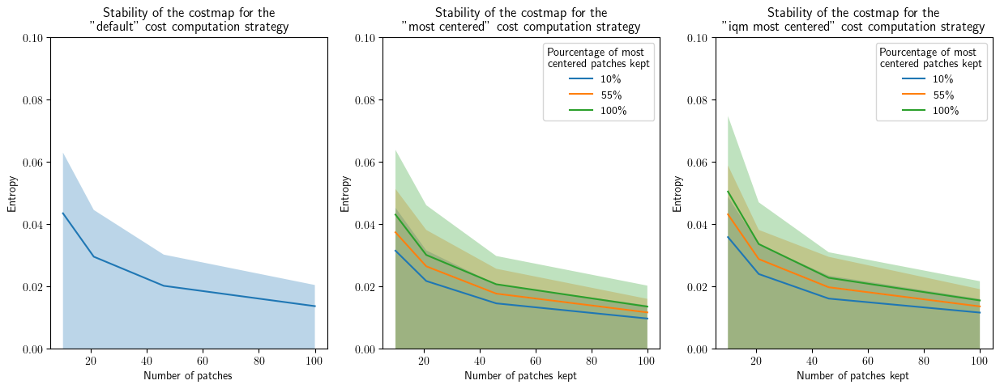

In [41]:
_, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(15, 5))
ylim = (0, 0.1)


def _plot_default(ax, entropy_df):
    default_grouped = entropy_df.loc[
        entropy_df.strategy == "default", ["nb_patch", "entropy"]
    ].groupby("nb_patch")
    entropy_list = default_grouped.mean()
    q1 = default_grouped.quantile(0.25)
    q3 = default_grouped.quantile(0.75)

    ax.plot(nb_patch_list, entropy_list)
    ax.fill_between(nb_patch_list, q1["entropy"], q3["entropy"], alpha=0.3)
    add_plot_detail(ax, "default", ylim=ylim, add_legend=False)


def _plot_centered(ax, entropy_df, strategy):
    for pourcentage in pourcentage_list:
        centered_grouped = entropy_df.loc[
            (entropy_df.strategy == strategy)
            & (entropy_df.pourcentage == pourcentage),
            ["nb_patch", "entropy"],
        ].groupby("nb_patch")

        entropy_list = centered_grouped.mean()
        q1 = centered_grouped.quantile(0.25)
        q3 = centered_grouped.quantile(0.75)

        ax.plot(nb_patch_list, entropy_list, label=f"{pourcentage}\%")
        ax.fill_between(nb_patch_list, q1["entropy"], q3["entropy"], alpha=0.3)

    add_plot_detail(ax, strategy, patch_kept=True, ylim=ylim)


_plot_default(ax1, entropy_df)
_plot_centered(ax2, entropy_df, "most centered")
_plot_centered(ax3, entropy_df, "iqm most centered")

In [42]:
# Most centered < IQM most centered
entropy_df.loc[
    (entropy_df.pourcentage == 10.0) | (entropy_df.strategy == "default"),
    ["strategy", "nb_patch", "entropy"],
].pivot_table(index="nb_patch", columns="strategy", values="entropy")

strategy,default,iqm most centered,most centered
nb_patch,,,
10,0.043473,0.035840,0.031467
21,0.029543,0.023972,0.021731
46,0.020190,0.016086,0.014554
100,0.013659,0.011590,0.009680


## Qualitative new results

In [43]:
def get_color_by_stable_cost(
    mask, img, depth, normal, *, alpha: float = 0.55
) -> np.array:
    cost = get_iqm_center_cost(
        mask, img, depth, normal, nb_total_patch=50, nb_centered_patch=25
    )
    if cost == 0:
        return np.array([0, 0, 0, 0])

    return colormap.to_rgba(cost, alpha=alpha)


def plot():
    img = get_image(img_path)
    depth = get_image(img_path.parent / (img_path.stem + "d.png"))
    normal = get_image(img_path.parent / (img_path.stem + "n.png"))

    masks = mask_generator.generate(img)
    masks = filter_intersection(masks)
    color_mask = mask_to_color_annotation(
        masks,
        color_fct=lambda mask: get_color_by_stable_cost(
            mask, img, depth, normal, alpha=1
        ),
        is_tqdm=False,
    )

    _, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 5))
    ax1.imshow(img)
    ax2.imshow(color_mask)

In [44]:
%%script false --no-raise-error

img_path = dir_path / "00015.png"
img = get_image(img_path)
depth = get_image(img_path.parent / (img_path.stem + "d.png"))
normal = get_image(img_path.parent / (img_path.stem + "n.png"))
masks = mask_generator.generate(img)

plot()

In [45]:
%%script false --no-raise-error

plot()

# Regrouping everything

In [46]:
@lru_cache
def get_colored_sam_costmap(img_path: Path):
    img = get_image(img_path)
    depth = get_image(img_path.parent / (img_path.stem + "d.png"))
    normal = get_image(img_path.parent / (img_path.stem + "n.png"))

    masks = mask_generator.generate(img)
    masks = filter_intersection(masks)
    color_mask = mask_to_color_annotation(
        masks,
        color_fct=lambda mask: get_color_by_stable_cost(
            mask, img, depth, normal, alpha=1
        ),
        is_tqdm=False,
    )
    return img, color_mask

In [47]:
def plot_sam_costmap(img_path: Path):
    img, color_mask = get_colored_sam_costmap(img_path)
    _, (ax1, ax2, ax3, ax4) = plt.subplots(1, 4, figsize=(15, 5))
    ax1.imshow(img)
    ax1.set_title(f"Original image ({img_path.stem})")

    masks = mask_generator.generate(img)
    all_masks = mask_to_color_annotation(masks)
    ax2.imshow(all_masks)

    completeness = compute_completeness(masks)
    ax2.set_title(
        "All masks (random color)\n" f"Completeness: {completeness * 100:.2f}%"
    )

    density = np.sum([m["segmentation"] for m in masks], axis=0)
    density_cmap = ax3.imshow(density, cmap="hot")
    ax3.set_title("Masks density\n" f"Number of masks: {len(masks)}")

    # ax4.imshow(img)
    # ax4.set_autoscale_on(False)
    ax4.imshow(color_mask)
    ax4.set_title("Costmap")

    plt.colorbar(density_cmap, ax=ax3, shrink=0.5)
    plt.colorbar(colormap, ax=ax4, shrink=0.5)

In [48]:
%%script false --no-raise-error

for img_path in tqdm(list(dir_path.glob("*[!nd].png")), desc="Precomputing"):
    get_colored_sam_costmap(img_path)

In [49]:
# %%script false --no-raise-error


@interact()
def plot(img_path=dir_path.glob("*[!nd].png")):
    plot_sam_costmap(img_path)

interactive(children=(Dropdown(description='img_path', options=(PosixPath('/home/g_thomas/Documents/PRE/bagfil…

# Possible to tune SAM's parameters to solve undersegmentation and too-large patches?

## Manual approach

In [ ]:
too_large_path = [
    "00015.png",
    "5.png",
    "00053.png",
    "6.png",
    "00048.png",
    "9.png",
]

lack_patches_path = [
    "00006.png",
    "00079.png",
    "00000.png",
    "00019.png",
    "11.png",
    "11.png",
]

normal_path = [
    "15.png",
    "12.png",
    "3.png",
    "2.png",
    "00037.png",
    "00027.png",
]

nb_line = len(too_large_path)


def plot_img_and_annot(mask_generator, axes, img_path):
    ax1, ax2 = axes

    img = get_image(img_path)
    ax1.imshow(img)

    masks = mask_generator.generate(img)
    color_mask = mask_to_color_annotation(masks, is_tqdm=False)
    ax2.imshow(color_mask)
    ax2.set_title(f"nb masks: {len(masks)}")


def plot_tuned_SAM(**kwargs):
    mask_generator = SamAutomaticMaskGenerator(sam, **kwargs)
    _, ax_grid = plt.subplots(nb_line, 8, figsize=(5 * 8, 5 * nb_line))
    for i in tqdm(np.arange(nb_line)):
        plot_img_and_annot(
            mask_generator, ax_grid[i, 0:2], dir_path / too_large_path[i]
        )
        plot_img_and_annot(
            mask_generator, ax_grid[i, 3:5], dir_path / lack_patches_path[i]
        )
        plot_img_and_annot(
            mask_generator, ax_grid[i, 6:8], dir_path / normal_path[i]
        )

100%|██████████| 6/6 [05:19<00:00, 53.31s/it]


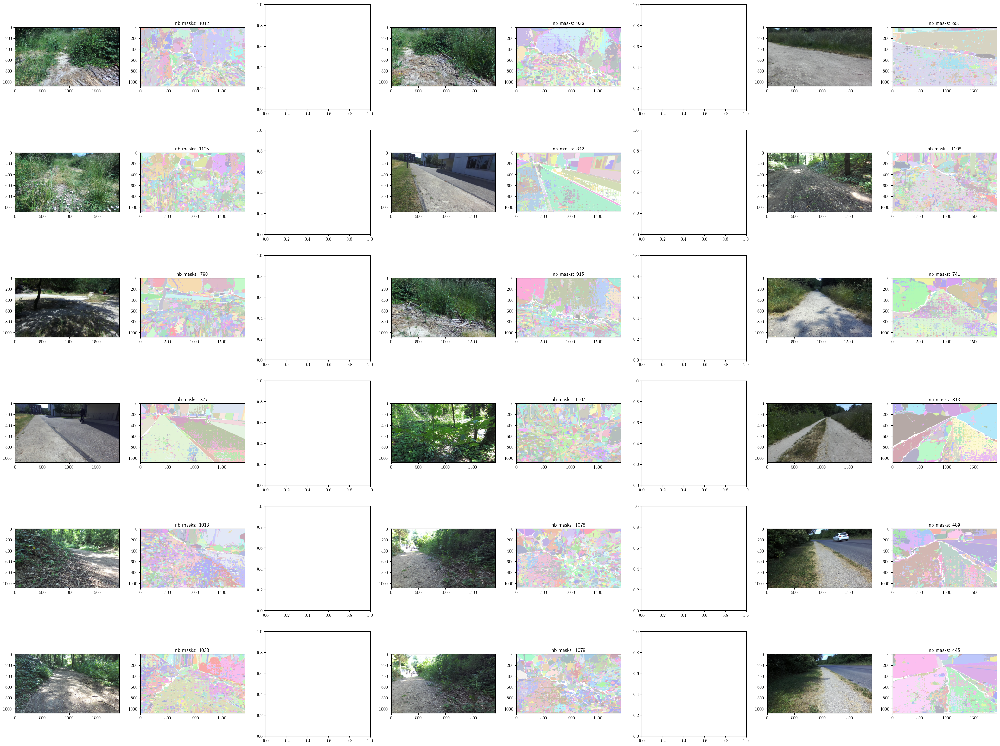

In [ ]:
# No filter?
plot_tuned_SAM(
    pred_iou_thresh=0.0, stability_score_thresh=0.0, stability_score_offset=0.0
)

100%|██████████| 6/6 [01:36<00:00, 16.10s/it]


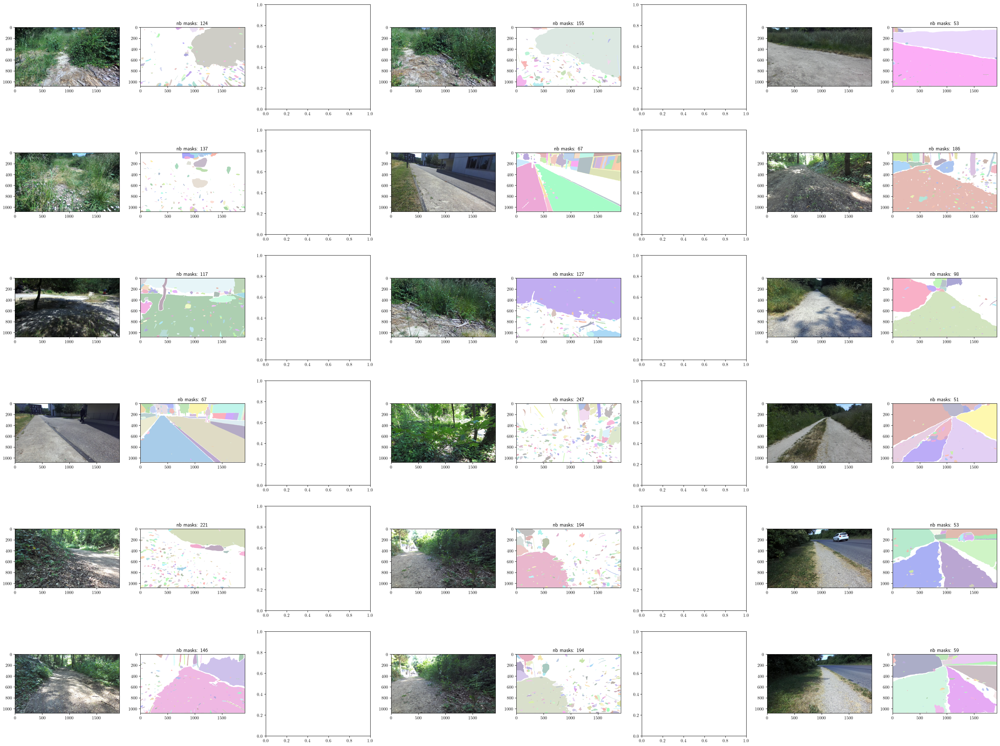

In [ ]:
plot_tuned_SAM(pred_iou_thresh=0.0)

100%|██████████| 6/6 [03:26<00:00, 34.37s/it]


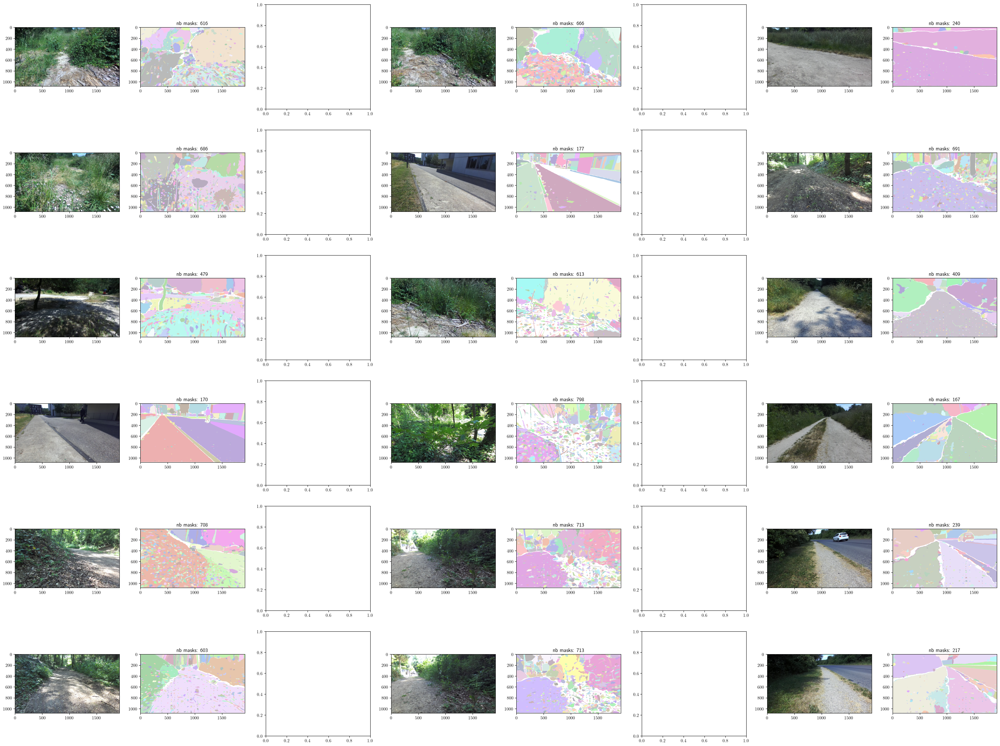

In [ ]:
plot_tuned_SAM(pred_iou_thresh=0.0, stability_score_thresh=0.75)

100%|██████████| 6/6 [22:59<00:00, 229.90s/it]


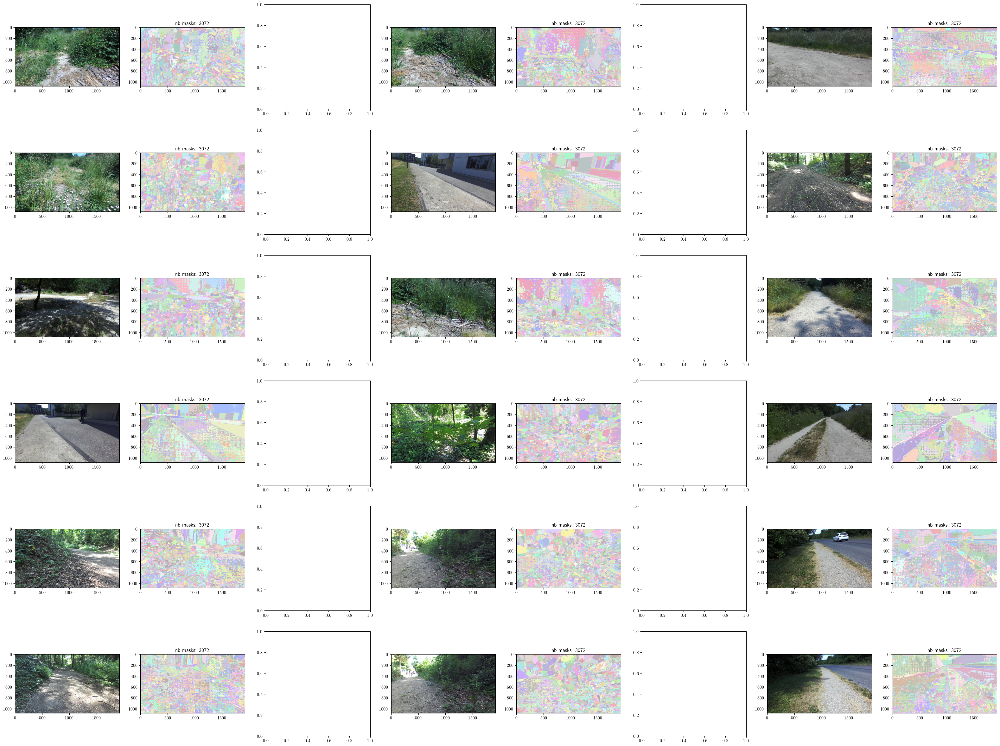

In [ ]:
plot_tuned_SAM(
    pred_iou_thresh=0.0,
    stability_score_thresh=0.0,
    stability_score_offset=0.0,
    box_nms_thresh=1,
)

100%|██████████| 6/6 [01:34<00:00, 15.81s/it]


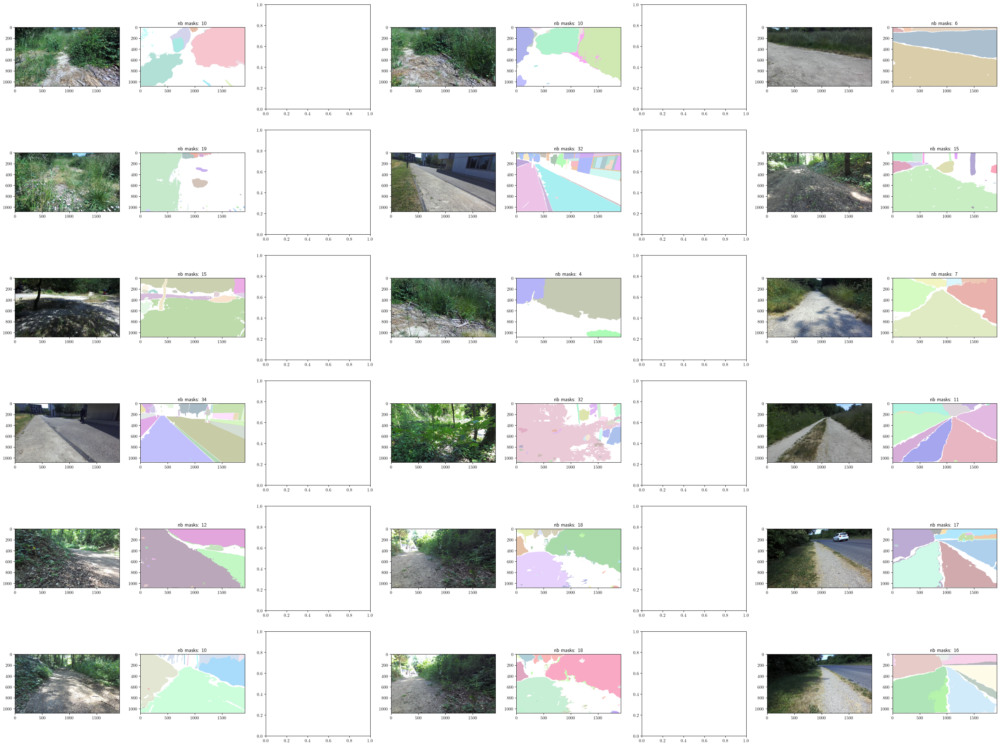

In [ ]:
plot_tuned_SAM(pred_iou_thresh=0.95, stability_score_thresh=0.5)

100%|██████████| 6/6 [02:09<00:00, 21.57s/it]


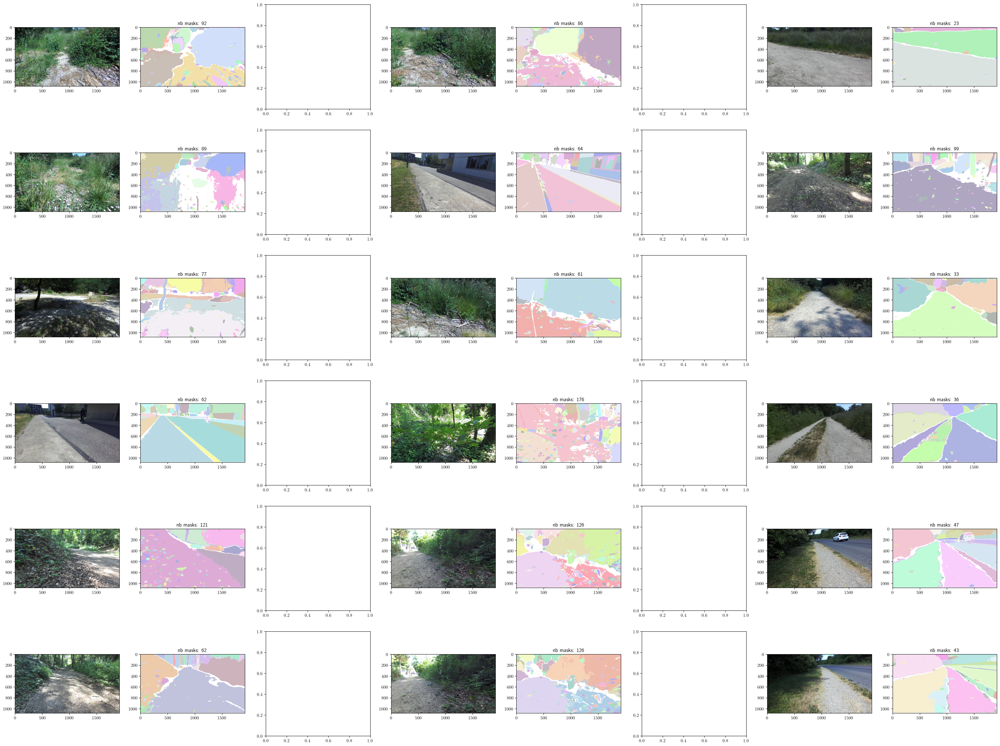

In [ ]:
plot_tuned_SAM(stability_score_thresh=0.5)

100%|██████████| 6/6 [01:58<00:00, 19.77s/it]


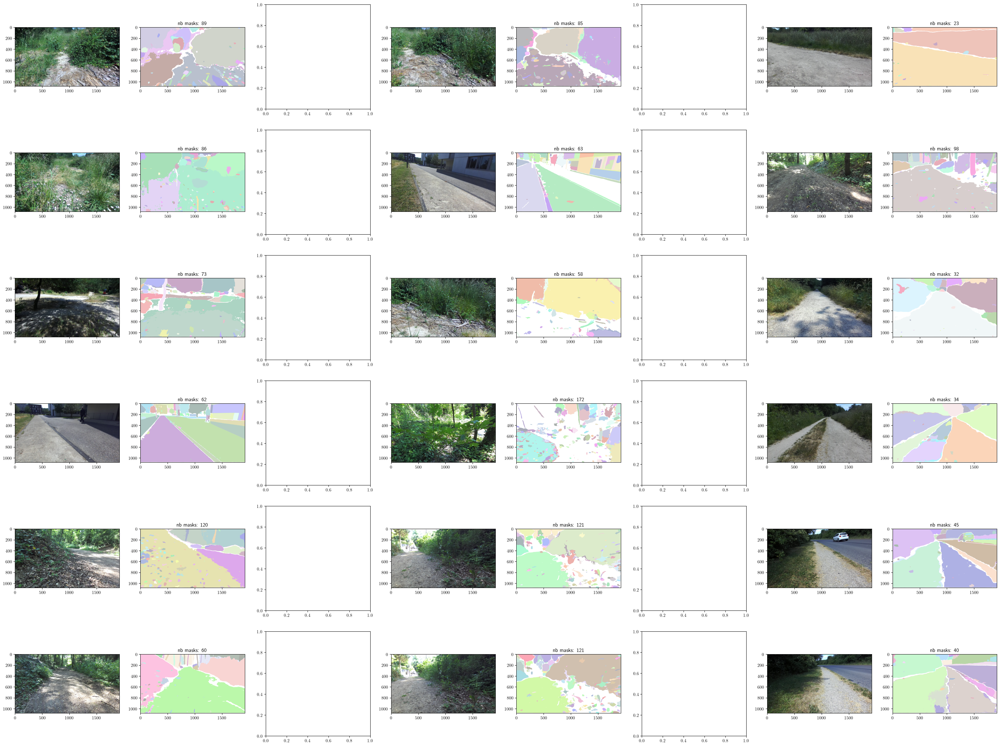

In [ ]:
plot_tuned_SAM(stability_score_thresh=0.75)

100%|██████████| 6/6 [02:12<00:00, 22.16s/it]


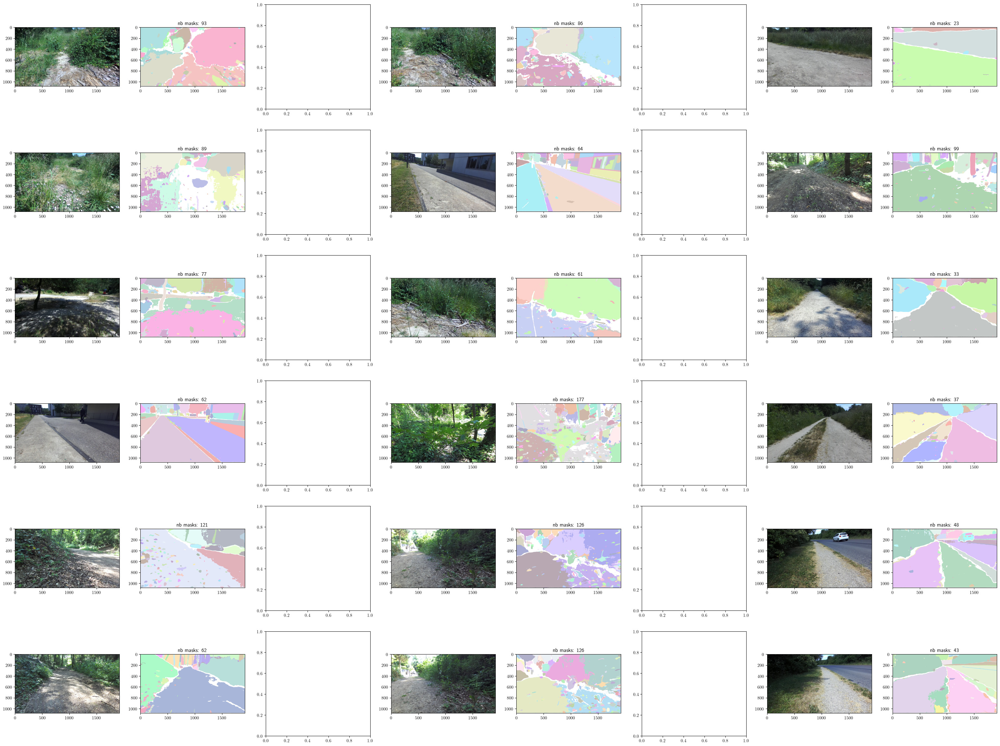

In [ ]:
plot_tuned_SAM(stability_score_offset=0.8, stability_score_thresh=0.5)

100%|██████████| 6/6 [01:30<00:00, 15.08s/it]


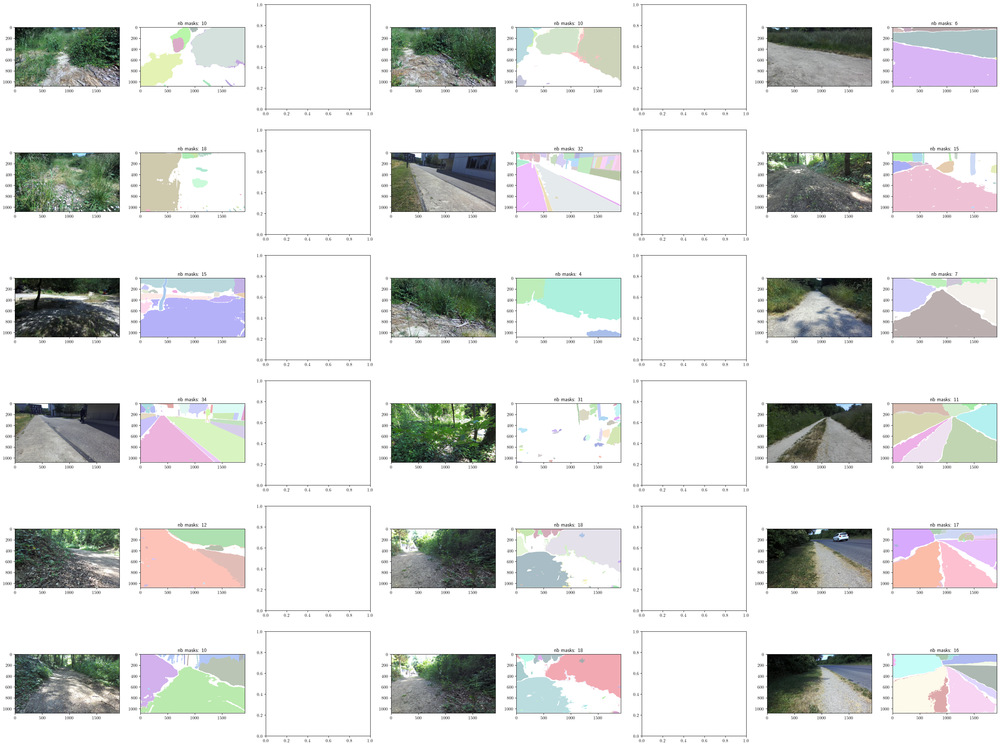

In [ ]:
plot_tuned_SAM(pred_iou_thresh=0.95, stability_score_thresh=0.75)

## Automatic approach

In [ ]:
from ray import tune
from ray.tune.search.optuna import OptunaSearch

from time import time


def eval_image(mask_generator, img_path):
    img = get_image(img_path)
    img = get_image(img_path)

    segmented_pxl = np.sum(
        reduce(np.logical_or, [m["segmentation"] for m in masks])
    )
    all_pxl = np.prod(img.shape[:2])

    nb_masks = len(masks)
    coverage = segmented_pxl / all_pxl * 100

    return coverage, nb_masks


def eval(config):
    from segment_anything import SamAutomaticMaskGenerator, sam_model_registry

    sam = sam_model_registry["vit_h"](
        checkpoint=params.dataset.sam_checkpoint,
    ).to("cuda")
    mask_generator = SamAutomaticMaskGenerator(sam, **config)

    total_nb_masks = 0
    coverage_list = []

    path_list = list(dir_path.glob("*[!nd].png"))
    start = time()
    for img_path in path_list:
        coverage, nb_masks = eval_image(mask_generator, img_path)

        coverage_list.append(coverage)
        total_nb_masks += nb_masks

    end = time()

    # Too many masks is too noisy and we won't be able to retrieve
    # anything relevant from it.
    # Too few (e.g. a single mask) is of no interest either.
    # So the goal is to maximaze the coverage, so that we have
    # a complete costmap, while minimizing the number of masks.
    mean_nb_masks = total_nb_masks / len(path_list)
    return {
        "time": end - start,
        "score": min(coverage_list) - abs(mean_nb_masks - 100) / 100,
        "mean coverage": np.mean(coverage_list),
        "mean nb_masks": mean_nb_masks,
    }


search_space = {
    # "points_per_side": tune.lograndint(10, 200),
    "pred_iou_thresh": tune.uniform(0, 1),
    "stability_score_thresh": tune.uniform(0, 1),
    "stability_score_offset": tune.uniform(0, 1),
    "box_nms_thresh": tune.uniform(0, 1),
    "min_mask_region_area": tune.lograndint(1, 1000),
}

In [ ]:
algo = OptunaSearch()
gpu_eval = tune.with_resources(eval, {"cpu": 12, "gpu": 1})

tuner = tune.Tuner(
    gpu_eval,
    tune_config=tune.TuneConfig(
        metric="score",
        mode="max",
        search_alg=algo,
        num_samples=100,
    ),
    param_space=search_space,
)
results = tuner.fit()

2023-11-09 08:52:36,229	WARNING worker.py:2074 -- Warning: The actor ImplicitFunc is very large (67 MiB). Check that its definition is not implicitly capturing a large array or other object in scope. Tip: use ray.put() to put large objects in the Ray object store.


RuntimeError: Caught unexpected exception: Task was killed due to the node running low on memory.
Memory on the node (IP: 147.250.35.113, ID: 1d203ee13aac38dbeccbefa72844cc9952f1e88adc67357a76a12903) where the task (actor ID: f2919ab412354f62e23be15301000000, name=ImplicitFunc.__init__, pid=291996, memory used=15.83GB) was running was 59.49GB / 62.49GB (0.952095), which exceeds the memory usage threshold of 0.95. Ray killed this worker (ID: 9d432a25cc759e1620a4e22f947adcc0f60c4e8d134a800441283092) because it was the most recently scheduled task; to see more information about memory usage on this node, use `ray logs raylet.out -ip 147.250.35.113`. To see the logs of the worker, use `ray logs worker-9d432a25cc759e1620a4e22f947adcc0f60c4e8d134a800441283092*out -ip 147.250.35.113. Top 10 memory users:
PID	MEM(GB)	COMMAND
291996	15.83	ray::ImplicitFunc.train
27728	9.50	/home/g_thomas/.cache/pypoetry/virtualenvs/traversability-analysis-FVBHScUm-py3.9/bin/python -m ipyk...
3062	6.04	/usr/share/code/code
3027	2.65	/usr/lib/firefox/firefox
3162	1.50	/usr/share/code/code --type=gpu-process --crashpad-handler-pid=3126 --enable-crash-reporter=ce2f5148...
215541	0.69	
3197	0.67	/usr/share/code/code --type=renderer --crashpad-handler-pid=3126 --enable-crash-reporter=ce2f5148-cd...
3245	0.50	/usr/share/code/code --type=utility --utility-sub-type=node.mojom.NodeService --lang=en-US --service...
3479	0.37	/usr/share/code/code --ms-enable-electron-run-as-node /home/g_thomas/.vscode/extensions/ms-python.vs...
291455	0.34	/home/g_thomas/.cache/pypoetry/virtualenvs/traversability-analysis-FVBHScUm-py3.9/lib/python3.9/site...
Refer to the documentation on how to address the out of memory issue: https://docs.ray.io/en/latest/ray-core/scheduling/ray-oom-prevention.html. Consider provisioning more memory on this node or reducing task parallelism by requesting more CPUs per task. Set max_restarts and max_task_retries to enable retry when the task crashes due to OOM. To adjust the kill threshold, set the environment variable `RAY_memory_usage_threshold` when starting Ray. To disable worker killing, set the environment variable `RAY_memory_monitor_refresh_ms` to zero.

(raylet) [2023-11-09 08:56:33,317 E 291516 291516] (raylet) node_manager.cc:3035: 1 Workers (tasks / actors) killed due to memory pressure (OOM), 0 Workers crashed due to other reasons at node (ID: 1d203ee13aac38dbeccbefa72844cc9952f1e88adc67357a76a12903, IP: 147.250.35.113) over the last time period. To see more information about the Workers killed on this node, use `ray logs raylet.out -ip 147.250.35.113`
(raylet) 
(raylet) Refer to the documentation on how to address the out of memory issue: https://docs.ray.io/en/latest/ray-core/scheduling/ray-oom-prevention.html. Consider provisioning more memory on this node or reducing task parallelism by requesting more CPUs per task. To adjust the kill threshold, set the environment variable `RAY_memory_usage_threshold` when starting Ray. To disable worker killing, set the environment variable `RAY_memory_monitor_refresh_ms` to zero.


In [ ]:
from ray import tune

results = tune.Tuner.restore(
    "/home/g_thomas/ray_results/eval_2023-10-23_14-38-41", trainable=gpu_eval
).get_results()

In [ ]:
results.get_best_result()

Result(
  metrics={'time': 946.3294856548309, 'score': 92.3688225308642, 'mean coverage': 99.17029441550926, 'mean nb_masks': 638.6},
  path='/home/g_thomas/ray_results/eval_2023-10-23_14-38-41/eval_30dfc115_95_box_nms_thresh=0.9759,min_mask_region_area=469,pred_iou_thresh=0.5630,stability_score_offset=0.8405,stability_sco_2023-10-24_09-40-52',
  filesystem='local',
  checkpoint=None
)

In [ ]:
results.get_best_result().config

(array([ 2.,  0.,  0.,  1.,  1.,  3.,  4.,  3.,  6.,  9., 14.,  3.,  7.,
        16.,  7.,  4.,  3.,  4.,  4.,  3.,  0.,  1.,  0.,  1.,  0.,  0.,
         0.,  1.,  1.,  2.]),
 array([   7.725     ,   51.58833333,   95.45166667,  139.315     ,
         183.17833333,  227.04166667,  270.905     ,  314.76833333,
         358.63166667,  402.495     ,  446.35833333,  490.22166667,
         534.085     ,  577.94833333,  621.81166667,  665.675     ,
         709.53833333,  753.40166667,  797.265     ,  841.12833333,
         884.99166667,  928.855     ,  972.71833333, 1016.58166667,
        1060.445     , 1104.30833333, 1148.17166667, 1192.035     ,
        1235.89833333, 1279.76166667, 1323.625     ]),
 <a list of 30 Patch objects>)

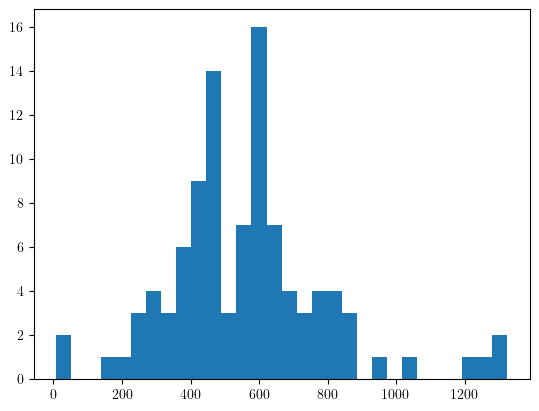

In [ ]:
import matplotlib.pyplot as plt

df = results.get_dataframe()
plt.hist(df["mean nb_masks"], bins=30)

In [ ]:
import plotly.express as px

fig = px.scatter(
    df, x="mean nb_masks", y="mean coverage", hover_data=df.columns
)
fig.show()

In [ ]:
# Did it solved the issues of the current dataset?
plot_tuned_SAM(
    pred_iou_thresh=0.68,
    stability_score_thresh=0.26,
    stability_score_offset=0.95,
    box_nms_thresh=0.58,
    min_mask_region_area=8,
)

In [ ]:
# Vs manual solution? (prefere the manual solution...)
plot_tuned_SAM(
    stability_score_thresh=0.5,
)

## Results on other images?

In [ ]:
new_mask_generator = SamAutomaticMaskGenerator(sam, stability_score_thresh=0.5)
new_dir_path = PROJECT_PATH / "bagfiles/images_extracted/from_terrain_samples"


@interact()
def plot(img_path=new_dir_path.glob("*[!nd].png")):
    img = get_image(img_path)
    plt.imshow(img)

    masks = new_mask_generator.generate(img)
    color_mask = mask_to_color_annotation(masks)

    plt.gca().set_autoscale_on(False)
    plt.imshow(color_mask)

interactive(children=(Dropdown(description='img_path', options=(PosixPath('/home/g_thomas/Documents/PRE/bagfil…

# How to complete segmentation?
Study cancelled: it might not be relevant toward the creation of a dataset for the distillation process (easier to filter on the "completeness" of segmentation than lowering post-processings' thresholds and hence diminishing the robustness to light changes and producing over-segmentation).

(Use math morphology?)

In [ ]:
from scipy.ndimage import binary_dilation


def fill_segmentation(masks: list) -> list:  # XXX: function not finished
    """
    Fill segmentation masks from the largest to the smallest in order to
    form a complete segmentation (i.e. the union of all masks has no hole).

    Only necessary modification are kept.
    """
    if len(masks) == 0:
        raise ValueError("Empty list of masks provided.")

    union_mask = np.zeros_like(masks[0]["segmentation"], dtype=bool)
    complete_segmentation_list = []
    masks_to_process = sorted(masks, key=(lambda x: x["area"]))

    while not np.all(union_mask):
        mask = masks_to_process.pop(0)
        new_segmentation = binary_dilation(
            mask["segmentation"], structure=np.ones((3, 3))
        )
        # If the dilated segmentation does not change the union mask,
        # then it won't help us any further to fill the holes.
        # Save it and move on to the next mask.
        if new_segmentation | union_mask == union_mask:
            complete_segmentation_list.append(mask)
        else:
            masks_to_process.append(
                {
                    "segmentation": new_segmentation,
                    "area": new_segmentation.sum(),
                }
            )

        union_mask |= new_segmentation

    # TODO Add the remaining masks

    return complete_segmentation_list

# Compute costmap grid based on SAM's segmentation
SAM's costmap is computed at the image's resolution which is too high for the planification task.
We downsample it to the grid resolution used before.

In [ ]:
@lru_cache
def get_sam_costmap(img_path: Path):
    img = get_image(img_path)
    depth = get_image(img_path.parent / (img_path.stem + "d.png"))
    normal = get_image(img_path.parent / (img_path.stem + "n.png"))

    masks = mask_generator.generate(img)
    masks = filter_intersection(masks)

    costmap = np.zeros_like(depth, dtype=np.float32)
    for mask in tqdm(masks):
        seg = mask["segmentation"]
        costmap[seg] = get_cost(mask, img, depth, normal)

    return img, costmap

100%|██████████| 89/89 [00:06<00:00, 12.83it/s]


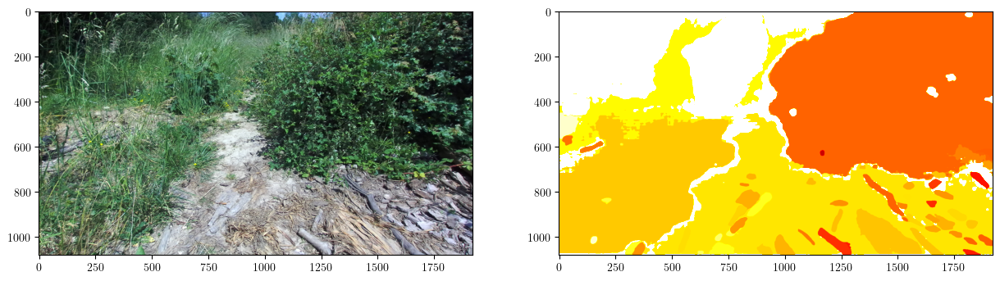

In [ ]:
img, sam_costmap = get_sam_costmap(dir_path / "00015.png")

_, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 15))
ax1.imshow(img)
ax2.imshow(sam_costmap, cmap="hot_r", norm=norm)

In [ ]:
costmap = downsample_to_grid(sam_costmap)

In [ ]:
def get_sam_colored_costmap_with_grid(img_path: Path) -> np.array:
    _, sam_colored_costmap = get_colored_sam_costmap(img_path)
    sam_colored_costmap_with_grid = sam_colored_costmap.copy()
    rectangle_list, grid_list = get_grid_lists()

    # For each costmap element
    for x in range(X):
        for y in range(Y):
            patch = rectangle_list[y, x]
            if patch is None:
                continue

            # Display the center of the cell
            points_image = grid_list[y, x]
            centroid = np.mean(points_image, axis=0)
            cv2.circle(
                sam_colored_costmap_with_grid,
                tuple(np.int32(centroid)),
                radius=4,
                color=(0, 0, 1, 1),
                thickness=-1,
            )

            # Display the frontiers of the cell
            points_image_reshape = points_image.reshape((-1, 1, 2))
            cv2.polylines(
                sam_colored_costmap_with_grid,
                np.int32([points_image_reshape]),
                True,
                (0, 1, 0, 1),
                3,
            )

    return sam_colored_costmap_with_grid


sam_colored_costmap_with_grid = get_sam_colored_costmap_with_grid(
    dir_path / "00015.png"
)

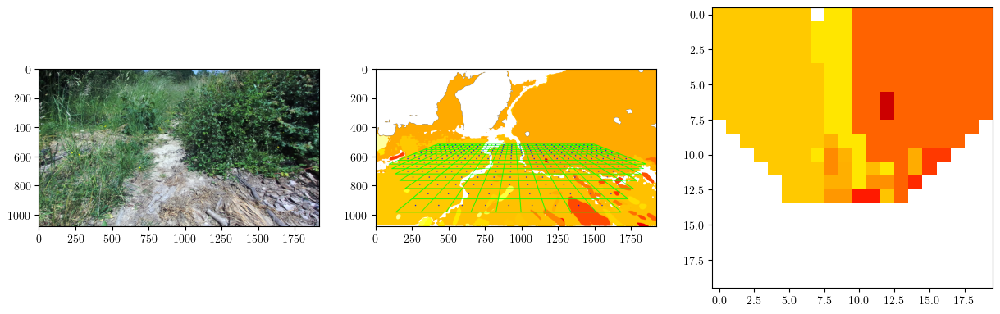

In [ ]:
# Note: You might see a slight divergence of color between ax2 and ax3.
# This is due to the recomputation of the costmap (and hence resampling random patches,
# which most likely will have different cost values).
# Converting the "sam_costmap" (which has the cost) to a colored costmap is not
# efficient as it requires to apply the "colormap.to_rgba" function to each pixel
# (which is quite a lot on a 1920x1080 resolution image, and therefore is slow to do...).

_, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(15, 15))
ax1.imshow(img)
ax2.imshow(sam_colored_costmap_with_grid)
ax3.imshow(costmap[::-1, :], cmap="hot_r", norm=norm)

In [ ]:
for img_path in tqdm(list(dir_path.glob("*[!nd].png")), desc="Precomputing"):
    get_colored_sam_costmap(img_path)
    get_sam_costmap(img_path)

In [ ]:
@interact()
def plot(img_path=dir_path.glob("*[!nd].png")):
    img, sam_costmap = get_sam_costmap(img_path)
    sam_colored_costmap_with_grid = get_sam_colored_costmap_with_grid(img_path)
    costmap = downsample_to_grid(sam_costmap)

    _, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(15, 15))
    ax1.imshow(img)
    ax2.imshow(sam_colored_costmap_with_grid)
    colormap = ax3.imshow(costmap[::-1, :], cmap="hot_r", norm=norm)

    plt.colorbar(colormap, ax=ax3, shrink=0.2)